<a href="https://colab.research.google.com/github/chaesh1201/Nvidia_AISpecialist_Certification/blob/main/Yolov5_AI_Specialist.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Yolo5 학습하기
##1. 구글 드라이브 연동

In [ ]:
# prompt: 구글 드라이브랑 연결

from google.colab import drive
drive.flush_and_unmount()  # 기존 마운트 해제
drive.mount('/content/drive')  # 다시 마운트

Drive not mounted, so nothing to flush and unmount.
Mounted at /content/drive


In [ ]:
%cd /content/drive/MyDrive

/content/drive/MyDrive


In [ ]:
%pwd

'/content/drive/MyDrive'

# 2. Yolov5 설치

In [ ]:
# 기존에 설치를 완료한 경우에는 해당 경로로 이동만 하면 됩니다.
%cd /content/drive/MyDrive/yolov5

/content/drive/MyDrive/yolov5


In [ ]:
##
#clone YOLOv5 and
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies

Cloning into 'yolov5'...
remote: Enumerating objects: 17067, done.
remote: Counting objects: 100% (45/45), done.
remote: Compressing objects: 100% (33/33), done.
remote: Total 17067 (delta 24), reused 28 (delta 12), pack-reused 17022 (from 1)
Receiving objects: 100% (17067/17067), 15.68 MiB | 19.09 MiB/s, done.
Resolving deltas: 100% (11714/11714), done.
/content/yolov5
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 896.3/896.3 kB 24.2 MB/s eta 0:00:00


In [ ]:
!pip install Pillow==10.3

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 37.1 MB/s eta 0:00:00
  Attempting uninstall: Pillow
    Found existing installation: pillow 11.0.0
    Uninstalling pillow-11.0.0:
      Successfully uninstalled pillow-11.0.0


# 3. 이미지 파일 관리

In [ ]:
!mkdir -p Train/labels
!mkdir -p Train/images
!mkdir -p Val/labels
!mkdir -p Val/images

In [ ]:
##검증 데이터 만들기
import os
import shutil
from sklearn.model_selection import train_test_split

def create_validation_set(train_path, val_path, split_ratio=0.3):
    """
    Train 데이터의 일부를 Val로 이동
    """
    # 필요한 디렉토리 생성
    os.makedirs(os.path.join(val_path, 'images'), exist_ok=True)
    os.makedirs(os.path.join(val_path, 'labels'), exist_ok=True)

    # Train 이미지 리스트 가져오기
    train_images = os.listdir(os.path.join(train_path, 'images'))
    train_images = [f for f in train_images if f.endswith(('.jpg', '.jpeg', '.png'))]


    _, val_images = train_test_split(train_images,
                                   test_size=split_ratio,
                                   random_state=42)

    # Val로 파일 복사
    for image_file in val_images:
        # 이미지 복사
        src_image = os.path.join(train_path, 'images', image_file)
        dst_image = os.path.join(val_path, 'images', image_file)
        shutil.copy2(src_image, dst_image)

        # 라벨 파일 복사
        label_file = os.path.splitext(image_file)[0] + '.txt'
        src_label = os.path.join(train_path, 'labels', label_file)
        dst_label = os.path.join(val_path, 'labels', label_file)
        if os.path.exists(src_label):
            shutil.copy2(src_label, dst_label)

    print(f"Created validation set with {len(val_images)} images")

# 실행
train_path = '/content/drive/MyDrive/yolov5/Train'
val_path = '/content/drive/MyDrive/yolov5/Val'

create_validation_set(train_path, val_path)

Created validation set with 300 images


In [ ]:
def check_dataset():
    train_path = '/content/drive/MyDrive/yolov5/Train'
    val_path = '/content/drive/MyDrive/yolov5/Val'

    # Train 데이터 확인
    train_images = len(os.listdir(os.path.join(train_path, 'images')))
    train_labels = len(os.listdir(os.path.join(train_path, 'labels')))

    # Val 데이터 확인
    val_images = len(os.listdir(os.path.join(val_path, 'images')))
    val_labels = len(os.listdir(os.path.join(val_path, 'labels')))

    print("Dataset status:")
    print(f"Train - Images: {train_images}, Labels: {train_labels}")
    print(f"Val - Images: {val_images}, Labels: {val_labels}")

# 데이터셋 상태 확인
check_dataset()

Dataset status:
Train - Images: 1000, Labels: 1000
Val - Images: 300, Labels: 300


# 4. 학습시작

In [ ]:
#필요 라이브러리 임포트하기
import torch
import os
from IPython.display import Image, clear_output  # to display images

In [ ]:
%pwd

'/content/drive/MyDrive/yolov5'

In [ ]:
import numpy as np
import tensorflow as tf
import os
from PIL import Image
from tensorflow.python.eager.context import eager_mode

def _preproc(image, output_height=512, output_width=512, resize_side=512):
    with eager_mode():
        h, w = image.shape[0], image.shape[1]
        scale = tf.cond(tf.less(h, w), lambda: resize_side / h, lambda: resize_side / w)
        resized_image = tf.compat.v1.image.resize_bilinear(tf.expand_dims(image, 0), [int(h*scale), int(w*scale)])
        cropped_image = tf.compat.v1.image.resize_with_crop_or_pad(resized_image, output_height, output_width)
        return tf.squeeze(cropped_image)

def Create_npy(imagespath, imgsize, ext) :
    images_list = [img_name for img_name in os.listdir(imagespath) if
                os.path.splitext(img_name)[1].lower() == '.'+ext.lower()]
    calib_dataset = np.zeros((len(images_list), imgsize, imgsize, 3), dtype=np.float32)

    for idx, img_name in enumerate(sorted(images_list)):
        img_path = os.path.join(imagespath, img_name)
        try:
            if os.path.getsize(img_path) == 0:
                print(f"Error: {img_path} is empty.")
                continue

            img = Image.open(img_path)
            img = img.convert("RGB")
            img_np = np.array(img)

            img_preproc = _preproc(img_np, imgsize, imgsize, imgsize)
            calib_dataset[idx,:,:,:] = img_preproc.numpy().astype(np.uint8)
            print(f"Processed image {img_path}")

        except Exception as e:
            print(f"Error processing image {img_path}: {e}")

    np.save('calib_set.npy', calib_dataset)

In [ ]:
# "cannot identify image file" 에러가 발생하는 경우, PILLOW Version을 "!pip install Pillow==10.1" 로 변경하여 설치합니다.
Create_npy('/content/drive/MyDrive/yolov5/Train/images', 512, 'jpg')

Instructions for updating:
Use `tf.image.resize(...method=ResizeMethod.BILINEAR...)` instead.


Processed image /content/drive/MyDrive/yolov5/Train/images/-_mp4-0000_jpg.rf.5a4b70fcfa49f9240eeb31cec848f76f.jpg
Processed image /content/drive/MyDrive/yolov5/Train/images/0322cb10-9ac8-11ea-a892-29ca52306077-4C045584-8C88-4916-B30C-A600095E1218-1189x794_jpeg.rf.217ae4d7c31953da7d5d202f6e9ff5e2.jpg
Processed image /content/drive/MyDrive/yolov5/Train/images/0_jpg.rf.a885fee2121b16f7aeddbb67ddf6720d.jpg
Processed image /content/drive/MyDrive/yolov5/Train/images/1000_F_596327230_M50q9mwsfDCLvkm4Y5HfFearAObk8jzk_jpg.rf.76c62e96500337c8f636299abc45593f.jpg
Processed image /content/drive/MyDrive/yolov5/Train/images/1120945_jpg.rf.c3476df0041cb720c195612216b126d3.jpg
Processed image /content/drive/MyDrive/yolov5/Train/images/11bf5644e407713598053ec0b9144610-dog-walking-guard-dog_jpg.rf.6e4fe7a92b11c19f7991948b7edd3f02.jpg
Processed image /content/drive/MyDrive/yolov5/Train/images/134829016-dogs-play-in-the-sand-on-the-beach-near-the-water_jpg.rf.d9b7ff2341ee76ba165d228e5ce14e2c.jpg
Processed

In [ ]:
#모델 학습하기
!python train.py --img 512 --batch 16 --epochs 200 --data /content/drive/MyDrive/yolov5/data.yaml --weights yolov5n.pt --cache

스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
    161/199      1.73G    0.02448    0.02322   0.001044         80        512:  95% 60/63 [00:16<00:00,  3.08it/s]/content/drive/MyDrive/yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):
    161/199      1.73G    0.02451    0.02324   0.001046        102        512:  97% 61/63 [00:16<00:00,  3.27it/s]/content/drive/MyDrive/yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):
    161/199      1.73G    0.02455    0.02336   0.001044        134        512:  98% 62/63 [00:16<00:00,  3.07it/s]/content/drive/MyDrive/yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):
    161/19

# 5. yolov5모델 학습 결과 검증

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [ ]:
!python detect.py --weights /content/drive/MyDrive/yolov5/runs/train/exp2/weights/best.pt --img 512 --conf 0.1 --source /content/drive/MyDrive/yolov5/Train/images

detect: weights=['/content/drive/MyDrive/yolov5/runs/train/exp2/weights/best.pt'], source=/content/drive/MyDrive/yolov5/Train/images, data=data/coco128.yaml, imgsz=[512, 512], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-385-gb968b2d7 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 1761871 parameters, 0 gradients, 4.1 GFLOPs
WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/1000 /content/drive/MyDrive/yolov5/Train/images/-_mp4-0000_jpg.rf.5a4b70fcfa49f9240eeb31cec848f76f.jpg: 512x512 1 cat, 8.9ms
image 2/1000 /content/drive/MyDrive/yolov5/Train/images/0322cb10-9ac8-11ea-a892-29ca523

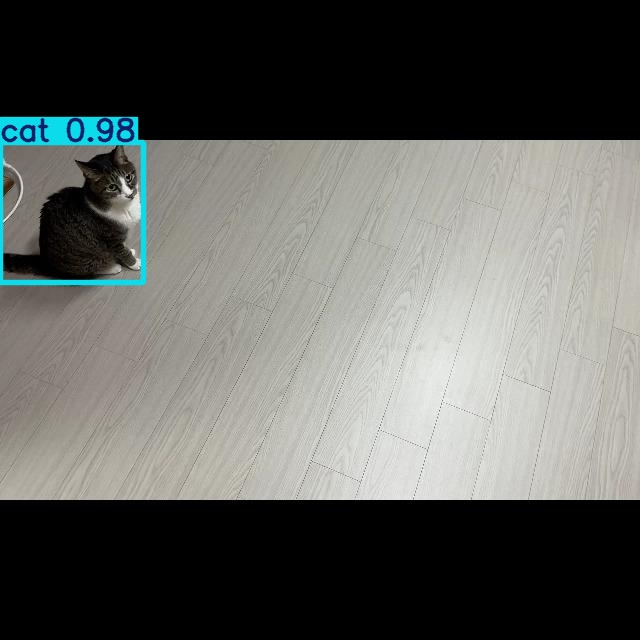

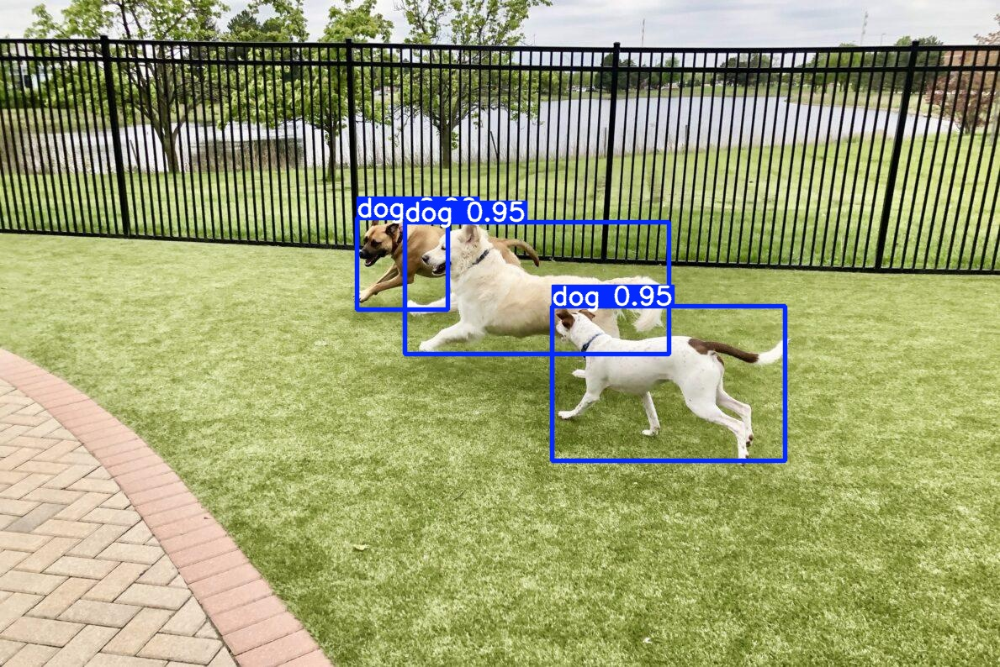

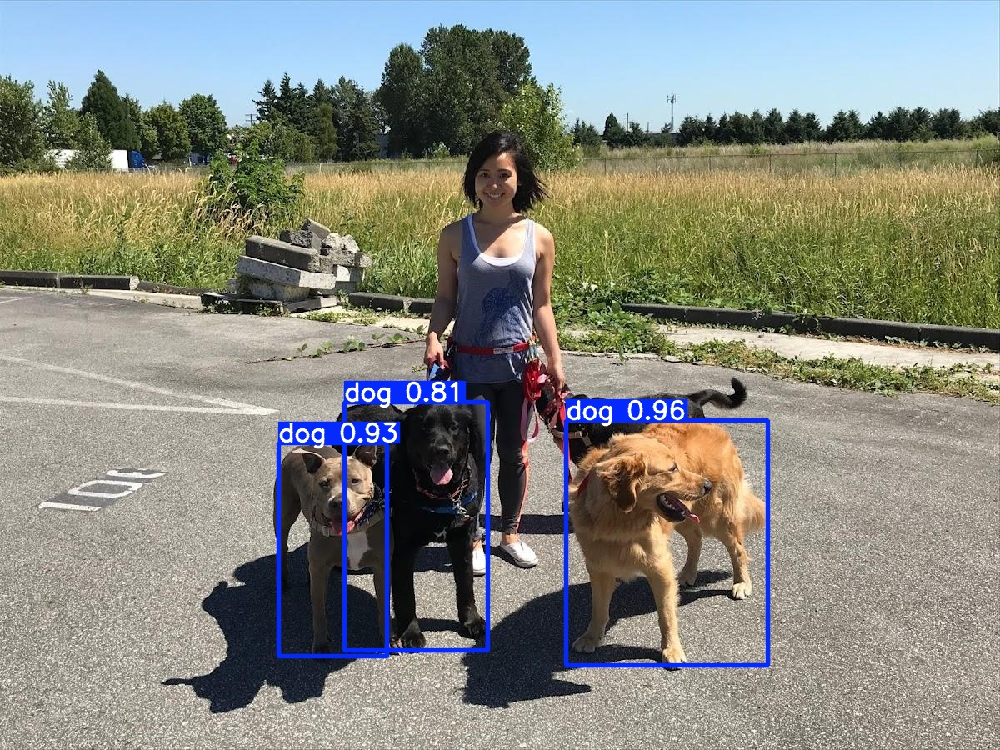

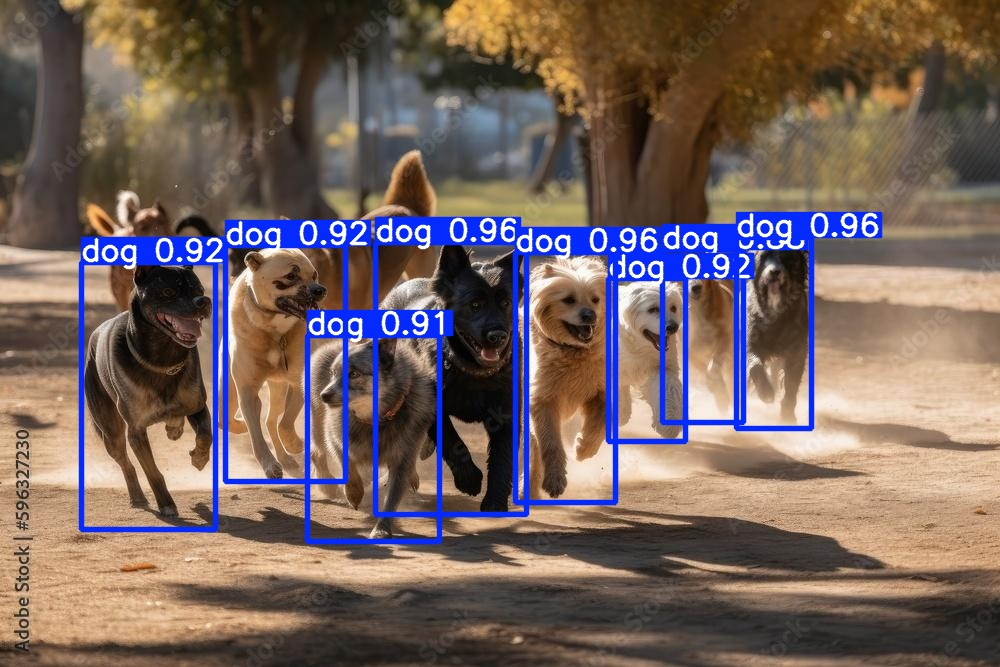

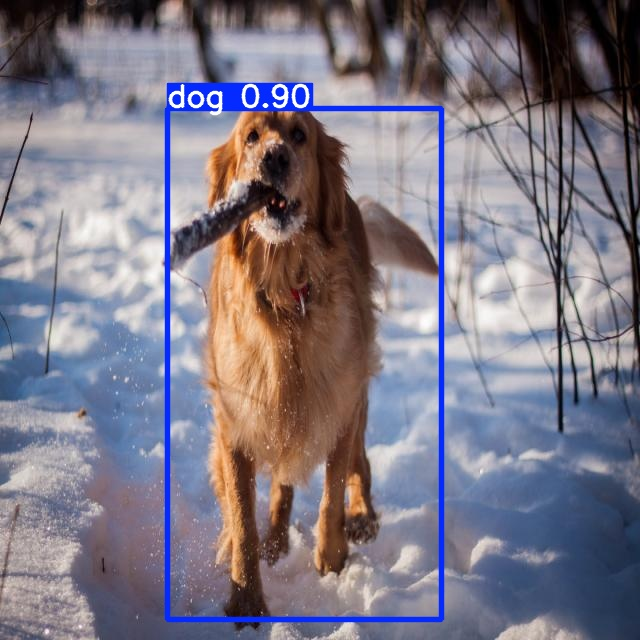

...

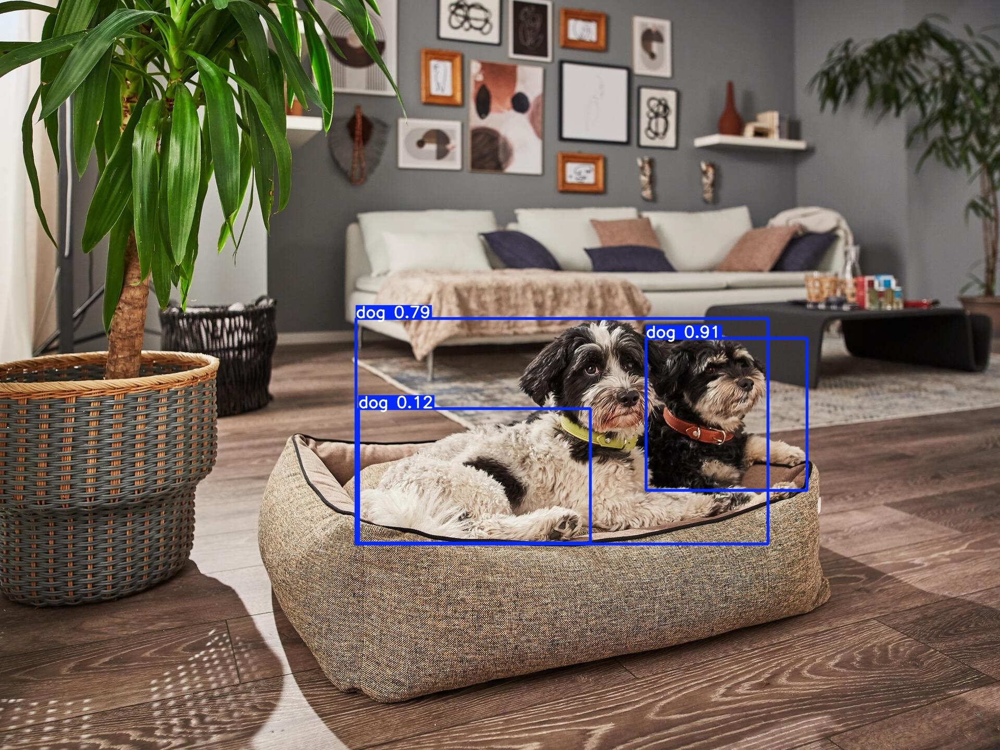

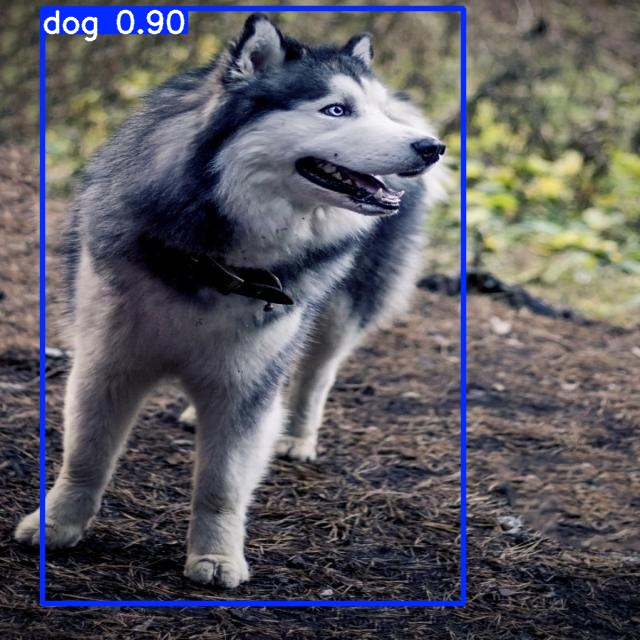

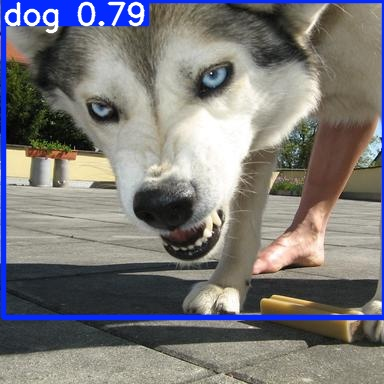

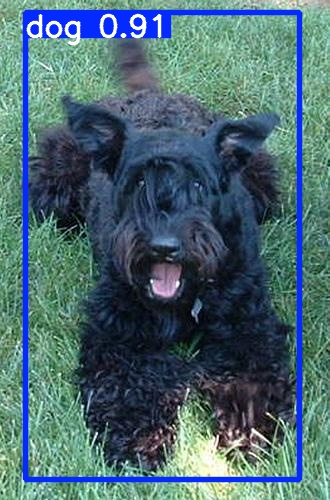

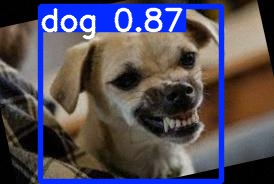

In [ ]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/drive/MyDrive/yolov5/runs/detect/exp6/*.jpg')[:30]: #이미지 파일 형식에 맞춰 .png 또는 .jpg 등으로 수정
    display(Image(filename=imageName))
    print("\n")